# [Traveling Santa](https://traveling-santa.reaktor.com/)

У *Санта-Клауса* есть список желаний детей из разных городов. Сани *Санта-Клаус* могут перевозить не более `10000 кг` за раз.

В файле `nicelist.txt` вы найдете желание каждого ребенка. Каждая строка содержит одно желание. В целях конфиденциальности мы опустили имена детей: вместо этого их файлы включают числовой идентификатор, их координаты на Земле и вес их подарка в `граммах`. Ваша задача - найти наиболее оптимальные маршруты доставки всех подарков.

*Санта-Клаус* отправляется из **Korvatunturi, Finland** `(68.073611N, 29.315278E)` и, основываясь на списке желаний детей, летает от одной координаты к другой, пока не будут доставлены все подарки, а затем возвращается в Корвантури. Чем короче общая продолжительность поездки, тем лучше. Предполагаем, что *Земля* представляет собой сферу с радиусом `6378` километров.

В качестве решения принимается `.csv` файл. Каждая строка данного файла должна содержать один набор подарков, начиная с Корватунтури, с перечислением всех детей, которых Санта посетит в пути, их идентификаторы, разделённые точкой с запятой.

**Условие**: Вы не можете превысить вместимость саней за один пробег. После того, как решение будет отправлено, мы подсчитаем общее пройденное расстояние для всех путей *Санта-Клауса*. Тот, кто доставит все подарки, преодолев наименьшее расстояние - побеждает!

Успехов!

Сначала я расскажу, о том как рождались идеи и проведу предварительный анализ данных, затем расскажу про реализацию, докажу и покажу, что решение является допустимым, расскажу о дальнейших улучшениях. 

## 1. Предварительный анализ

### 1.1 Исходные данные 

Сначала посмотрим на данные, которые у нас есть.

In [17]:
import re
import folium
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from copy import deepcopy
from sklearn.cluster import KMeans
from math import radians, sin, cos, asin, sqrt, pi, atan, atan2, fabs

cols = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4',
        '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', 
        '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', 
        '#000075', '#808080']

In [18]:
weight_column_name = 'Weight (g)'
df = pd.read_csv('nicelist.txt', 
                 sep=';', 
                 header=None, 
                 index_col=0, 
                 names=['Latitude', 'Longitude', weight_column_name])
df.index.name = 'name'

In [19]:
df

,Latitude,Longitude,Weight (g)
name,,,
2,40.733034,-86.762233,342917
3,43.029635,-91.094895,974703
4,31.180215,16.596037,215099
5,-28.657398,-55.964951,568144
6,36.186751,-86.355754,695570
...,...,...,...
9997,7.346531,134.460417,177074
9998,40.702376,-78.210798,752916
9999,33.463295,-84.314389,54772


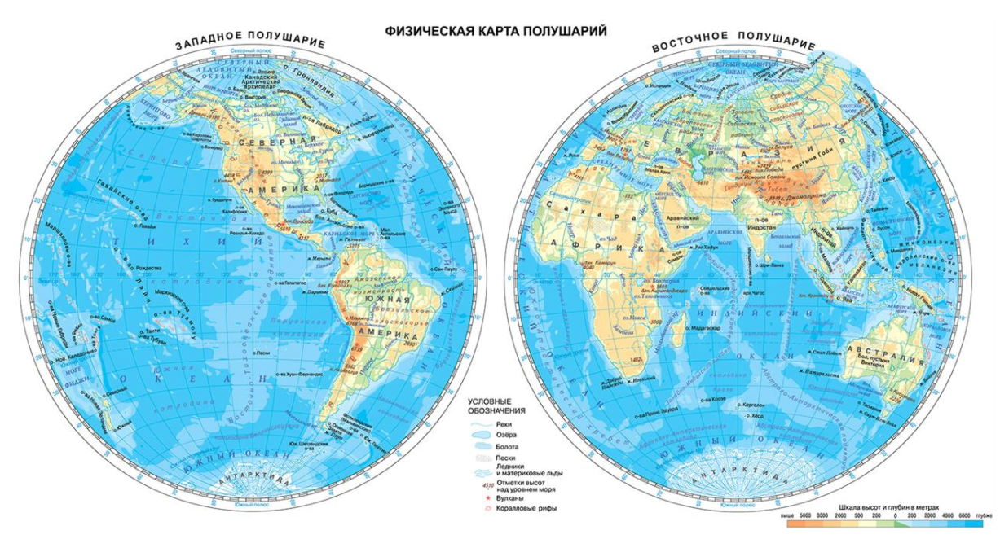


Разберёмся с исходными данными. 

- `name` - уникальный идентификатор города;
- `Latitude` - *широта*, идёт с севера (`N`) на юг (`S`), измеряется в градусах, лежит в интервале $\operatorname{Lat} \in [-90, 90]$
    - $\operatorname{Lat} = 0 $ - экватор
    - $\operatorname{Lat} <0 $ - южное полушарие
    - $\operatorname{Lat} >0 $ - сереверное полушарие
- `Longitude` - *долгота*, идёт с запада (`W`) на восток (`E`), измеряется в градусах, лежит в интервале $\operatorname{Long} \in [-180, 180]$
    - $\operatorname{Long} = 0 $ - основной меридиан (через Гринвич проходящий)
    - $\operatorname{Long} < 0 $ - западное полушарие
    - $\operatorname{Long} > 0 $ - восточное полушарие

- `Weight(g)` - вес подарка в граммах (`g`)

Координаты каждого города на *Земле (Earth)* задаются с помощью пары `Latitude, Longitude`.

Посмотрим на распределение весов подарков, которые нам необходимо перевозить

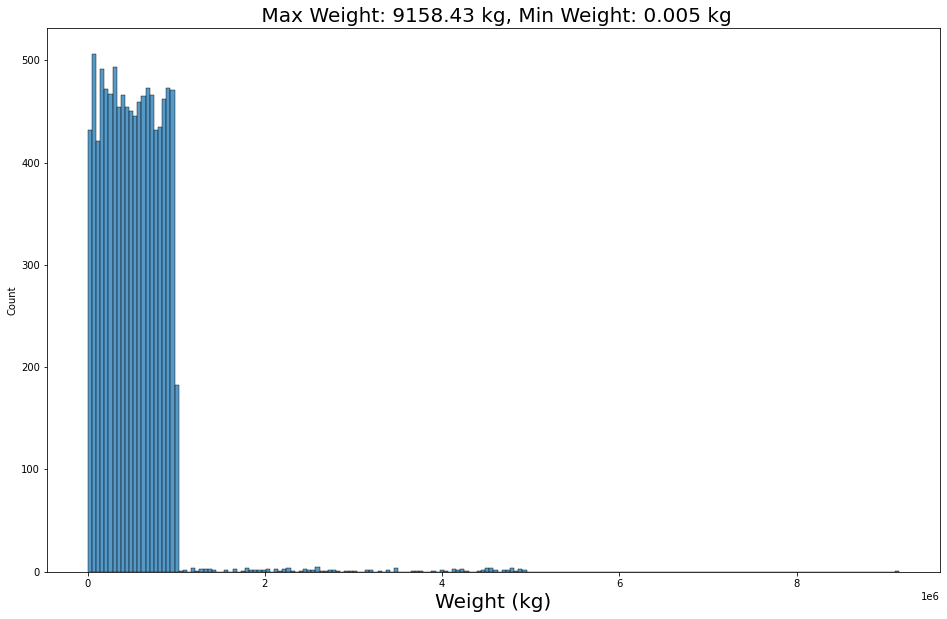

In [20]:
fig, ax = plt.subplots(1, 1, figsize=(16, 10))
sns.histplot(df['Weight (g)'], ax=ax)
ax.set_title(f" Max Weight: {max(df['Weight (g)'] / 1000)} kg, Min Weight: {min(df['Weight (g)'] / 1000)} kg", fontsize=20)
ax.set_xlabel('Weight (kg)', fontsize=20)
plt.show()

Видим, что большинство подарков весят около килограмма, но главное, что максимальный вес меньше вместимости саней - ура мы можем решить задачу `CVRP`.

### 1.2 Кластеризация

In [34]:
def from_to_splitter(ser:'pd.Series')->'pd.Series':
    lat, lon = ser['Latitude'], ser['Longitude']
    lat, lon = np.deg2rad(lat), np.deg2rad(lon)
    R = 6378
    x = R * np.cos(lat) * np.cos(lon)
    y = R * np.cos(lat) * np.sin(lon)
    z = R * np.sin(lat)
    return pd.Series([x, y, z])

df[['x', 'y', 'z']]=df.apply(from_to_splitter,axis=1)
df

,Latitude,Longitude,Weight (g),x,y,z
name,,,,,,
2,40.733034,-86.762233,342917,272.965008,-4825.267427,4161.870777
3,43.029635,-91.094895,974703,-89.089354,-4661.472199,4352.197608
4,31.180215,16.596037,215099,5229.342362,1558.540829,3302.092207
5,-28.657398,-55.964951,568144,3132.480515,-4637.970908,-3058.704903
6,36.186751,-86.355754,695570,327.191766,-5137.254905,3765.692710
...,...,...,...,...,...,...
9997,7.346531,134.460417,177074,-4430.583411,4514.829325,815.555517
9998,40.702376,-78.210798,752916,987.889004,-4733.214004,4159.284135
9999,33.463295,-84.314389,54772,527.128678,-5294.602172,3516.846201


In [35]:
k = 20
df[['x', 'y', 'z']]=df.apply(from_to_splitter,axis=1)
coords_2 = df[['x', 'y', 'z']]
model = KMeans(n_clusters=k, random_state=42).fit(coords_2)
class_predictions = model.predict(coords_2)
df[f'KM'] = class_predictions

In [38]:
mkmeans = create_map(df, f'KM', cols)
mkmeans

Решить задачу относительно `10000` вершин, наверное, очень сложно, поэтому была предложена идея в прошлом домашнем задании кластеризовать наши данные хотя бы на кластеры, соответствующие географическому положению, тем самым уменьшая вычислительную сложность задачи. Но даже при данной кластеризации у нас получалось очень большое количество вершин в каждом кластере, поэтому было принято решение разбить на большее количество кластеров (а именно примерно `n_clusters = 20`, и, как будет видно выше, в принципе полученные кластеры можно как-то охарактеризовать полученные кластеры с точки зрения географии, но они уже будут сложнее называться.

В качестве алгоритма кластеризации применялся алгоритм кластеризации `KMeans`. Посмотрим на то, какая кластеризация у нас получилась.

In [4]:
k = 20
coords = df[['Latitude', 'Longitude']]
model = KMeans(n_clusters=k, random_state=42).fit(coords)
class_predictions = model.predict(coords)
df[f'KM'] = class_predictions

In [6]:
df[(df['KM']==4) & (df['Longitude']==0)]

,Latitude,Longitude,Weight (g),KM
name,,,,
8826,-90.0,0.0,8520,4


In [37]:
def create_map(df, cluster_column, cols):
    '''
    Визуализация городов на карте
    '''
    m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=9, tiles='Stamen Toner')

    for _, row in df.iterrows():

        if row[cluster_column] == -1:
            cluster_colour = '#000000'
        else:
            cluster_colour = cols[int(row[cluster_column])]

        folium.CircleMarker(
            location= [row['Latitude'], row['Longitude']],
            radius=5,
            popup= row[cluster_column],
            color=cluster_colour,
            fill=True,
            fill_color=cluster_colour
        ).add_to(m)
        
    folium.CircleMarker(
            location=[68.073611, 29.315278],
            radius=15,
            color='black',
            fill=True,
            fill_color='black'
        ).add_to(m)
        
    return m

In [319]:
mkmeans = create_map(df, f'KM', cols)
mkmeans

Черным кружочком место старта. Видно, что в принципе все вполне неплохо, но вот есть кто-то, кто живёт на южном полюсе и это, конечно жесть. 

Сделаем лишь одно улучшение - так как Земля всё-таки сфера (да, я понимаю, что нужно какую-то крутую кластеризацию придумать, но пока что так), поэтому красные вершины (если навести и жмякнуть на кружочки, то увидим номер кластера) под кластером `4`, переведём в фиолетовый класс (`Австралия`, класс `7`).

In [320]:
test = df.loc[df.index.isin(df[df['KM']==14].index)]
for i in test.itertuples():
    df.at[i[0], 'KM'] = 7

Ещё раз проиллюстрируем нашу кластеризацию.

In [321]:
mkmeans = create_map(df, f'KM', cols)
mkmeans

Вот так-то лучше.

### 1.3 Расстояние между двумя городами на сфере

Так как у нас предполагается, что города находятся на планете *Земля*, которая в свою очередь является сферой, то обычное евклидово расстояние не способно вычислить реальное расстояние между городами. Для подсчёта расстояния используется формула [`great_circle`](https://en.wikipedia.org/wiki/Great-circle_distance).

Реализация (сравнение так же можно посмотреть) взята из данного [файла](https://gist.github.com/habibutsu/8bbcc202a915e965c6a6d4f561d0e482).

In [ ]:
def great_circle(point1, point2, EARTH_MEAN_RADIUS=6371008.8):
    '''
        Calculating great-circle distance
        (see https://en.wikipedia.org/wiki/Great-circle_distance)
    '''
    lat1, lon1 = (radians(coord) for coord in point1)
    lat2, lon2 = (radians(coord) for coord in point2)

    dlon = fabs(lon1 - lon2)
    dlat = fabs(lat1 - lat2)

    numerator = sqrt(
        (cos(lat2) * sin(dlon))**2 +
        ((cos(lat1) * sin(lat2)) - (sin(lat1) * cos(lat2) * cos(dlon)))**2)

    denominator = (
        (sin(lat1) * sin(lat2)) +
        (cos(lat1) * cos(lat2) * cos(dlon)))

    c = atan2(numerator, denominator)
    return EARTH_MEAN_RADIUS * c / 1000

Проверим, что данная функция вообще адекватно считает расстояние между городами и мы можем доверять ей. Сравним с сайтом каким-нибудь для проверки. От двух координат точек на сфере `(Latitude_1, Longitude_1)` и `(Latitude_2, Longitude_2)` возвращается длина в километрах между данными городами.

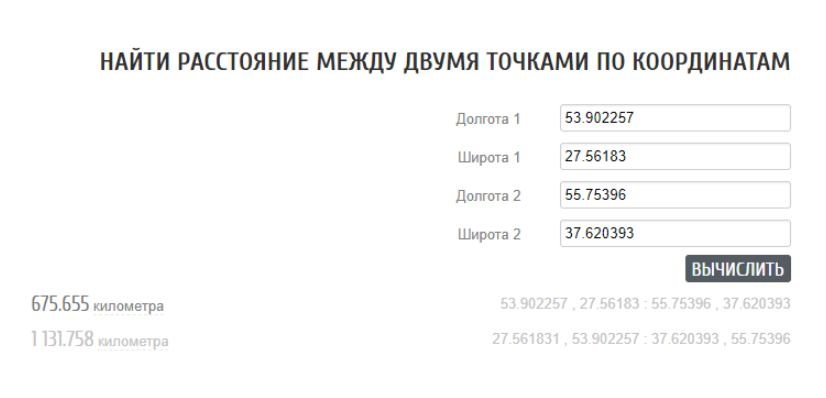

In [322]:
p_minsk = (53.902257, 27.561831)
p_moscow = (55.75396, 37.620393)
great_circle(p_minsk, p_moscow)

675.6562994818709

Ура, высчитывает прекрасно.

Перейдем к самому алгоритму.

## 2. Алгоритм решения и подготовка к нему

Сначала опишу, как будет выглядеть мой подход к поиску решения:

- сначала, как уже было рассказано, происходит кластеризация исходных данных на количество кластеров `n_clusters`
- затем для каждой вершины я нахожу `K` ближайших соседей - наиболее вероятные кандидаты для следующей вершины при построении маршрута

Это была подготовительная часть, а дальше начинается алгоритм:

    1. Будем рассматривать последовательно каждый отдельный кластер и вершины, находящиеся в нём.
    2. Далее проводятся следующие действия:
        - будем рассматривать каждую вершину и строить маршрут в предположении, что данная вершина является начальной (то есть следующей после вершины старта пути в `Korvatunturi, Finland`)
        - в предположении, что данная вершина начальная, будем пытаться строить очередной маршрут внутри данного кластера, выбирая ближайших соседей для данной начальной вершины.  добавление происходит до того момента, пока:
            - при добавлении очередной вершины мы получим переполнение грузоподёмности саней (станет больше `10000 kg`)
            - кончаются ближайшие соседи. если ближайшие соседи заканчиваются, то выбирается вершины из данного кластера и добавляется в предполагаемый маршрут саней Санта-Клауса, пока не достигнем переполнения
        - далее из данных вершин в найденном допустимом маршруте мы генерируем размером max_population перестановок вершин в допустиом маршруте и выбираем маршрут с наименьшей суммарной длиной от начальной вершины Korvatunturi до Korvatunturi конечной, проходящей через каждые выбранные вершины. маршрут с минимальной длиной добавляется, вершины, в найденном оптимальном маршруте удаляются из вершин, которые необходимо пройти в данном кластере и начинают строиться другие маршруты в данном кластере, пока все вершины не кончатся
        - когда все вершины кончаются, мы берем следующую вершину в кластере в предположении, что она начальная и проделываем такие же операции для неё. если суммарная длина всех маршрутов для данной вершины меньше минимального найденного значения до этой вершины, то данные маршруты добавляются в качестве лучших (с минимальной длиной) и так находятся маршруты для кластеров
        - пройдясь по всем вершинам в кластере мы найдем маршруты, минимальные по суммарной длине, добавим их списку найденных маршрутов, а длину маршрутов - к пройденной до этого кластере длине остальных маршрутов
        - повторяем для всех кластеров и находим то, что от нас требуется - а) маршруты б) длины маршрутов. данный алгоритм является допустимым (учитывает грузоподёмность) и 2оптимальным, так как работает с ближайшими соседями
        
Теперь можно переходить к тому, как это всё реалузиуется. Вкратце расскажу про схему реализации.

### 2.1 Ближайшие соседи.

Для поиска ближайших соседей была использована хорошая и быстрая реализация вычисления этой самой матрицы и поиска в нём ближайших соседей. Реализация была написана при написании метода `K` ближайших соседей в этом семестре на дополнительных занятих по анализу данных. 

Так как кластеризация проводилась с помощью `KMeans`, то удобным способом подсчёта будет являться евклидова метрика расстояния. Да, я прекрасно понимаю, что это не особо вяжется с шаром, но для данного метода кластеризации данный подход к нахождению ближайших соседей будет являться оптимальным. Есть предположения по поводу связи методов кластеризации и поисков ближайших соседей: например перевести `Latitude` и `Longitude` в `x, y, z` координаты, или написать векторизованную функцию `great_circle`, но это уже тонкости реализации, к которым я не смог подступиться. 

Итого, поиск соседей проводился с помощью двух функций: `euclidean_distance` - высчитывает матрицу расстояний, а затем функция `get_best_ranks` выдаёт `top` ближайших соседей. Здесь было учтено два момента: при вычислении наивным способом расстояния при $X \in R^{l1 \times d}$ и $Z \in R^{l12\times d}$ получается $3d$ операции операции - $d$ вычитаний, $d$ возведений в квадрат, $d$ сложений и общее расстояние для двух объектов вычисляется за $3dl_1l_2$ операций. Но раскрыв скобки в формуле евклидового расстояния, мы получим, что можно вычислить две суммы квадратов по $x$ и $z$ и вычитаем удвоенную сумму попарных произведений - общее число операций - $2dl_1l_2$. Второй момент - эффективно реализован поиск соседей.

In [323]:
def get_best_ranks(ranks, top, axis=1, return_ranks=False):
    '''
        Находит top-ближайших соседей для выборки
    '''
    indices = np.take(np.argpartition(ranks, range(-top, 0), axis=axis),
                      range(-1, -top-1, -1), axis=axis)
    result = (indices, )
    if return_ranks:
        ranks = np.take_along_axis(ranks, indices, axis=axis)
        result = (ranks, ) + result
    return result if len(result) > 1 else result[0]

def euclidean_distance(x, y):
    '''

    Parameters
    ----------
    x : np.ndarray размера N x D
        обучающая выборка.
    y : np.ndarray размера M x D
        тестовая выборка.

    Raises
    ------
    NotImplementedError
        DESCRIPTION.

    Returns
    -------
    Функция возвращает np.ndarray размера N x M,
    каждый элемент которого - евклидово расстояния между
    соответствующей парой векторов из массивов x и y.
    Уменьшим число операций с помощью трюка, раскрывая скобки.
    '''
    x2 = np.sum(x**2, axis=1).reshape(-1, 1)
    y2 = np.sum(y**2, axis=1)
    result = np.sqrt(x2 + y2 - 2 * x @ y.T)
    return result

### 2.2 Как реализовывается: множество классов

Для реализации изложенного выше алгоритма мне потребовалось ввести некоторое количество классов. У каждого класса есть документация и говорящие названия методов, поэтому с этим можно познакомиться ниже.

Начнём с самого очевидного (хотя очевидными тут будут все): `class Wishes`

In [324]:
class Wishes:
    
    def __init__(self, 
                 wish_id: int, 
                 wish_lat: float, 
                 wish_long: float, 
                 wish_w: float):
        '''
        Уникальный экземпляр каждого города с подарком.

        Parameters
        ----------
        wish_id : int
            Уникальный идентификатор города, 
            в котором находится подарок ребёнку.
        wish_lat : float
            latitude (широта) города.
        wish_long : float
            longitude (долгота) города.
        wish_w : float
            вес желаемого подарка (граммы).

        Returns
        -------
        None.

        '''
        self.wish_id = wish_id
        self.wish_lat = wish_lat
        self.wish_long = wish_long
        self.wish_w = wish_w

Каждый экземпляр класса - отдельный город из таблицы `df`. Всё просто. Теперь нам необходимо иметь возможность получить информацию о ребре очередного маршрута и о расстоянии между двумя экземплярами класса `Wishes`. Для этого был написан класс `Edges`

In [325]:
class Edges:
    def __init__(self, v1: Wishes, v2: Wishes):
        '''
        Edges:
            Данный класс содержит информацию о ребре между двумя городами
            с подарками и информацию о расстоянии между городами

        Parameters
        ----------
        v1 : Wishes
            экземпляр класса Wishes #1.
        v2 : Wishes
            экземпляр класса Wishes #2.
        self.e : (Wishes_1, Wishes_2)
            ребро, соединяющее два города
        self.dist : (float)
            расстояние между городами на сфере(в километрах)

        Returns
        -------
        None.

        '''
        self.e = (v1, v2) if v1.wish_id < v2.wish_id else (v2, v1)
        self.dist = great_circle((v1.wish_lat, v1.wish_long), 
                                 (v2.wish_lat, v2.wish_long))

Собственно всё логично - задаётся ребро и расстояние в километрах по методу `great_circle`, чтобы оценивать длину маршрута. Теперь нашему Дедушке Морозу необходимо придумать сани, на которых он бы катался. Давайте это реализуем: класс `SantaPulka`!

In [326]:
class SantaPulka:
    
    def __init__(self, max_weight: int=10000*1000):
        '''
        SantaPulka:
            класс, характеризующий информацию о Санях Санта-Клауса. 
            Формирует маршрут, по которому поедет Санта в очередной свой путь.

        Parameters
        ----------
        max_weight : int, optional
            максимальная вместимость саней (в грамах). The default is 10000*1000.
        self.visit : list
            список посещённых городов
        self.current_capacity : float
            текущая наполненность саней (в грамах). the default is 0.

        Returns
        -------
        None.

        '''
        self.current_capacity = 0
        self.visit = []
        self.max_weight = max_weight
        
    def add(self, vertex):
        '''
        Метод add доваляет вершину vertex в маршрут visit,
        если текущая наполненность саней + вес подарка в vertex.wish_w 
        не превосходит max.weight саней Санта Клауса.

        Parameters
        ----------
        vertex : Wishes
            экземпляр класса Wishes.

        Returns
        -------
        bool
            возвращает:
                True: если мы можем посетить данный город, 
                не переполнив вместимость саней Санта-Клауса. Вершина 
                vertex добавляется в маршрут, наполненность саней
                увеличивается на величину веса подарка в данной вершине
                                                (vertex.wish_w)
                False:
                    если:
                        - вершина уже есть в маршруте (на всякий случай)
                        - при добавлении вершины в маршрут превышается 
                        вместимость саней Санта-Клауса

        '''
        if vertex in self.visit:
            return False
        
        if self.current_capacity + vertex.wish_w <= self.max_weight:
            self.visit.append(vertex)
            self.current_capacity += vertex.wish_w
            return True
        return False

У каждого экземпляра саней есть вместимость, есть проверка на то, можно ли добавить очередной город в предполагаемый список городов, которые Санта посещает в очередном маршруте. Можно апргейдить сани - задавать вместимость (`max_weight`), но в задании сказано, что сани ограничены вместимостью в `10000 kg`, поэтому такая вместимость и задана.

Также был создан отдельный класс для маргшрута Санты `SantaWay`:

In [327]:
class SantaWay:
    
    def __init__(self):
        '''
        SantaWay: 
            данный класс содержит информацию о машруте, который задаётся
            списком рёбер (экземпляры класса Edges)
            Содержит в себе следующие методы:
                add(edg) : добавление очередного ребра в путь
                calculate_length_of_route : возвращается длина машрута
                is_way_is_correct : является ли маршрут корректным
        
        self.edges : list
            содержит список рёбер маршрута. default is [].

        Returns
        -------
        None.

        '''
        self.edges = []
        
    def add(self, edg):
        '''
        Метод add добавляет очередное ребро в маршрут (если это возможно).

        Parameters
        ----------
        edg : Edges
            экземпляр класса Edges.

        Returns
        -------
        bool
            возвращает:
                True: если ребро edg не находится в текущем маршруте.
                    Ребро edg добавляется в маршрут.
                False: если ребро edg есть в маршруте.

        '''
        if edg in self.edges:
            return False
        else:
            self.edges.append(edg)
            return True

    def calculate_length_of_route(self):
        '''
        Высчитывает длину текущего маршрута.

        Returns
        -------
        float
            длина текущего машрута из рёбер (км).

        '''
        return sum([e.dist for e in self.edges])

    def is_way_is_correct(self):
        '''
        Является ли маршрут корректным (нет повторяющихся вершин и.т.д)
        
        '''
        if len(self.edges) == 0:
            return False
        all_edges = []
        for edg in self.edges:
            all_edges.append(edg.e[0].wish_id)
            all_edges.append(edg.e[1].wish_id)
        unique_vertices_in_route = np.unique(all_edges, return_counts = True)
        return np.all(unique_vertices_in_route[1]==2)

Он содержит информацию о рёбрах маршрута, может посчитать общую длину текущего маршрута, может добавить ребро в маршрут. Так же можно проверить, что путь у нас там замкнутый, нет повторенй вершин (на всякий случай).

Для формирования маршрута применяется следующая функция:

In [328]:
def generate_traveling(santa_pulka: SantaPulka, santa_home: Wishes):
    '''
    Формирование путешествия Санта Клауса на его волшебных санях (Pulka).

    Parameters
    ----------
    santa_pulka : SantaPulka
        экземпляр класса SantaPulka, наполненный городами, 
            которые он собирается посетить в очередном маршруте.
    santa_home : Wishes
        экземпляр класса Wishes.

    Returns
    -------
    tour : SantaWay
        экземпляр класса SantaWay, составленный из рёбер маршрута, с началом
        в вершине start, содержащий все ребра маршрута из намеченных городов
        Сантой, и заканчивающий так же в вершине start.

    '''
    tour = SantaWay()
    towns_to_visit = santa_pulka.visit
    tour.add(Edges(santa_home, towns_to_visit[0]))
    for i in np.arange(len(towns_to_visit) - 1):
        tour.add(Edges(towns_to_visit[i], towns_to_visit[i+1]))
    tour.add(Edges(towns_to_visit[-1], santa_home))
    return tour 

На вход принимается экземпляр класса саней Санта-Клауса и экземпляр класса Wishes - начальной вершины **Korvatunturi, Finland** `(68.073611N, 29.315278E)` и генерируется замкнутый маршрут по вершинам саней с начальном в `santa_home` и концом в нём же. 

С помощью данных функций, классов и описания алгоритма выше был реализован алгоритм поиска минимального маршрута для Санты. Перейдем к реализации и получению результатов.

## 3. Реализация

Сначала идут все методы и классы, предоставленные выше.

In [1]:
import re
import folium
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from copy import deepcopy
from sklearn.cluster import KMeans
from math import radians, sin, cos, asin, sqrt, pi, atan, atan2, fabs

def from_to_splitter(ser:'pd.Series')->'pd.Series':
    lat, lon = ser['Latitude'], ser['Longitude']
    lat, lon = np.deg2rad(lat), np.deg2rad(lon)
    R = 6378
    x = R * np.cos(lat) * np.cos(lon)
    y = R * np.cos(lat) * np.sin(lon)
    z = R * np.sin(lat)
    return pd.Series([x, y, z])

def create_map(df, cluster_column, cols):
    '''
    Визуализация городов на карте
    '''
    m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=9, tiles='Stamen Toner')

    for _, row in df.iterrows():

        if row[cluster_column] == -1:
            cluster_colour = '#000000'
        else:
            cluster_colour = cols[int(row[cluster_column])]

        folium.CircleMarker(
            location= [row['Latitude'], row['Longitude']],
            radius=5,
            popup= row[cluster_column],
            color=cluster_colour,
            fill=True,
            fill_color=cluster_colour
        ).add_to(m)
        
    return m

def great_circle(point1, point2, EARTH_MEAN_RADIUS=6371008.8):
    '''
        Calculating great-circle distance
        (see https://en.wikipedia.org/wiki/Great-circle_distance)
    '''
    lat1, lon1 = (radians(coord) for coord in point1)
    lat2, lon2 = (radians(coord) for coord in point2)

    dlon = fabs(lon1 - lon2)
    dlat = fabs(lat1 - lat2)

    numerator = sqrt(
        (cos(lat2) * sin(dlon))**2 +
        ((cos(lat1) * sin(lat2)) - (sin(lat1) * cos(lat2) * cos(dlon)))**2)

    denominator = (
        (sin(lat1) * sin(lat2)) +
        (cos(lat1) * cos(lat2) * cos(dlon)))

    c = atan2(numerator, denominator)
    return EARTH_MEAN_RADIUS * c / 1000

def get_best_ranks(ranks, top, axis=1, return_ranks=False):
    '''
        Находит top-ближайших соседей для выборки
    '''
    indices = np.take(np.argpartition(ranks, range(-top, 0), axis=axis),
                      range(-1, -top-1, -1), axis=axis)
    result = (indices, )
    if return_ranks:
        ranks = np.take_along_axis(ranks, indices, axis=axis)
        result = (ranks, ) + result
    return result if len(result) > 1 else result[0]

def euclidean_distance(x, y):
    '''

    Parameters
    ----------
    x : np.ndarray размера N x D
        обучающая выборка.
    y : np.ndarray размера M x D
        тестовая выборка.

    Raises
    ------
    NotImplementedError
        DESCRIPTION.

    Returns
    -------
    Функция возвращает np.ndarray размера N x M,
    каждый элемент которого - евклидово расстояния между
    соответствующей парой векторов из массивов x и y.
    Уменьшим число операций с помощью трюка, раскрывая скобки.
    '''
    x2 = np.sum(x**2, axis=1).reshape(-1, 1)
    y2 = np.sum(y**2, axis=1)
    result = np.sqrt(x2 + y2 - 2 * x @ y.T)
    return result

In [2]:
class Wishes:
    
    def __init__(self, 
                 wish_id: int, 
                 wish_lat: float, 
                 wish_long: float, 
                 wish_w: float):
        '''
        Уникальный экземпляр каждого города с подарком.

        Parameters
        ----------
        wish_id : int
            Уникальный идентификатор города, 
            в котором находится подарок ребёнку.
        wish_lat : float
            latitude (широта) города.
        wish_long : float
            longitude (долгота) города.
        wish_w : float
            вес желаемого подарка (граммы).

        Returns
        -------
        None.

        '''
        self.wish_id = wish_id
        self.wish_lat = wish_lat
        self.wish_long = wish_long
        self.wish_w = wish_w
        
class Edges:
    def __init__(self, v1: Wishes, v2: Wishes):
        '''
        Edges:
            Данный класс содержит информацию о ребре между двумя городами
            с подарками и информацию о расстоянии между городами

        Parameters
        ----------
        v1 : Wishes
            экземпляр класса Wishes #1.
        v2 : Wishes
            экземпляр класса Wishes #2.
        self.e : (Wishes_1, Wishes_2)
            ребро, соединяющее два города
        self.dist : (float)
            расстояние между городами на сфере(в километрах)

        Returns
        -------
        None.

        '''
        self.e = (v1, v2) if v1.wish_id < v2.wish_id else (v2, v1)
        self.dist = great_circle((v1.wish_lat, v1.wish_long), 
                                 (v2.wish_lat, v2.wish_long))
        
class SantaPulka:
    
    def __init__(self, max_weight: int=10000*1000):
        '''
        SantaPulka:
            класс, характеризующий информацию о Санях Санта-Клауса. 
            Формирует маршрут, по которому поедет Санта в очередной свой путь.

        Parameters
        ----------
        max_weight : int, optional
            максимальная вместимость саней (в грамах). The default is 10000*1000.
        self.visit : list
            список посещённых городов
        self.current_capacity : float
            текущая наполненность саней (в грамах). the default is 0.

        Returns
        -------
        None.

        '''
        self.current_capacity = 0
        self.visit = []
        self.max_weight = max_weight
        
    def add(self, vertex):
        '''
        Метод add доваляет вершину vertex в маршрут visit,
        если текущая наполненность саней + вес подарка в vertex.wish_w 
        не превосходит max.weight саней Санта Клауса.

        Parameters
        ----------
        vertex : Wishes
            экземпляр класса Wishes.

        Returns
        -------
        bool
            возвращает:
                True: если мы можем посетить данный город, 
                не переполнив вместимость саней Санта-Клауса. Вершина 
                vertex добавляется в маршрут, наполненность саней
                увеличивается на величину веса подарка в данной вершине
                                                (vertex.wish_w)
                False:
                    если:
                        - вершина уже есть в маршруте (на всякий случай)
                        - при добавлении вершины в маршрут превышается 
                        вместимость саней Санта-Клауса

        '''
        if vertex in self.visit:
            return False
        
        if self.current_capacity + vertex.wish_w <= self.max_weight:
            self.visit.append(vertex)
            self.current_capacity += vertex.wish_w
            return True
        return False
    
class SantaWay:
    
    def __init__(self):
        '''
        SantaWay: 
            данный класс содержит информацию о машруте, который задаётся
            списком рёбер (экземпляры класса Edges)
            Содержит в себе следующие методы:
                add(edg) : добавление очередного ребра в путь
                calculate_length_of_route : возвращается длина машрута
                is_way_is_correct : является ли маршрут корректным
        
        self.edges : list
            содержит список рёбер маршрута. default is [].

        Returns
        -------
        None.

        '''
        self.edges = []
        
    def add(self, edg):
        '''
        Метод add добавляет очередное ребро в маршрут (если это возможно).

        Parameters
        ----------
        edg : Edges
            экземпляр класса Edges.

        Returns
        -------
        bool
            возвращает:
                True: если ребро edg не находится в текущем маршруте.
                    Ребро edg добавляется в маршрут.
                False: если ребро edg есть в маршруте.

        '''
        if edg in self.edges:
            return False
        else:
            self.edges.append(edg)
            return True

    def calculate_length_of_route(self):
        '''
        Высчитывает длину текущего маршрута.

        Returns
        -------
        float
            длина текущего машрута из рёбер (км).

        '''
        return sum([e.dist for e in self.edges])

    def is_way_is_correct(self):
        '''
        Является ли маршрут корректным (нет повторяющихся вершин и.т.д)
        
        '''
        if len(self.edges) == 0:
            return False
        all_edges = []
        for edg in self.edges:
            all_edges.append(edg.e[0].wish_id)
            all_edges.append(edg.e[1].wish_id)
        unique_vertices_in_route = np.unique(all_edges, return_counts = True)
        return np.all(unique_vertices_in_route[1]==2)
    
def generate_traveling(santa_pulka: SantaPulka, santa_home: Wishes):
    '''
    Формирование путешествия Санта Клауса на его волшебных санях (Pulka).

    Parameters
    ----------
    santa_pulka : SantaPulka
        экземпляр класса SantaPulka, наполненный городами, 
            которые он собирается посетить в очередном маршруте.
    santa_home : Wishes
        экземпляр класса Wishes.

    Returns
    -------
    tour : SantaWay
        экземпляр класса SantaWay, составленный из рёбер маршрута, с началом
        в вершине start, содержащий все ребра маршрута из намеченных городов
        Сантой, и заканчивающий так же в вершине start.

    '''
    tour = SantaWay()
    towns_to_visit = santa_pulka.visit
    tour.add(Edges(santa_home, towns_to_visit[0]))
    for i in np.arange(len(towns_to_visit) - 1):
        tour.add(Edges(towns_to_visit[i], towns_to_visit[i+1]))
    tour.add(Edges(towns_to_visit[-1], santa_home))
    return tour 

А здесь был реализован класс `SantaSolver` с разбиением на кластеры, препроцессингом, нахождением ближайших соседей и реализацией алгоритма.

In [3]:
import warnings
warnings.filterwarnings("ignore")

class SantaSolver:
    
    def __init__(self, filename='nicelist.txt'):
        '''
        SantaSolver:
            класс, реализающий маршрут санты относительно введённог количества кластеров 
            и количества ближайших соседей.

        Parameters
        ----------
        filename : str
            имя файла, в которым хранится информация о городах. The default is 'nicelist.txt'.
        self.weight_column_name : str
            Название столбца веса (неважный параметре). The default is 'Weight (g)'.
        self.df : pd.DataFrame
            исходные данные о Wishes, содержит 3 столбца:
                Latitude - широта города
                Longitude - долгота города
                self.weight_column_name - вес подарка
            index name - уникальный идентификатор города (Wishes.wish_id)
        self.cols : list
            список цветов для прорисовки на географической карте.
        self.earth_radius : int
            радиус планеты Земля (в километра). The default is 6378.
        self.hometown : Wishes
            экземпляр класса Wishes, начальная вершина, откуда начинает свой путь Санта-Клаус:
            Город Korvatunturi, Finland: (68.073611, 29.315278) - ширина, долгота
            wish_id: 1, wish_w: 0
        self.wishes : dict
            словарь с экземплярами Wishes для каждого ключа (wish_id).
        self.clustered_wishes: dict
            словарь с кластеризованными городами после preprocessing
        self.k_nearest_dict : dict
            словарь, где для каждому городу сопоставляется k ближайших объекта (в виде списка)
        self.preprocessed : bool
            был ли произведён preprocessing (кластеризовано ли, найдены ли ближайшие соседы).
            the default is False.

        Returns
        -------
        None.

        '''
        self.weight_column_name = 'Weight (g)'
        self.df = pd.read_csv(filename, 
                              sep=';', 
                              header=None, 
                              index_col=0, 
                              names=['Latitude', 'Longitude', self.weight_column_name])
        self.df.index.name = 'name'
        self.cols = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4',
        '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', 
        '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', 
        '#000075', '#808080']
        self.earth_radius = 6378
        self.hometown = Wishes(*[1, 68.073611, 29.315278, 0])
        self.santa_sani_max_weight = 10000 * 1000
        self.wishes = {}
        self.clustered_wishes = {}
        self.k_nearest_dict = {}
        self.coords = self.df[['Latitude', 'Longitude']].values
        self.preprocessed = False

        
    def _preprocessed_clustered_wishes(self, 
                                       n_clusters=20, 
                                       improvment=False, 
                                       clusterisation_method='xyz'):
        '''
        _preprocessed_clustered_wishes :
            препроцессинг кластеризации городов

        Parameters
        ----------
        n_clusters : int
            Количество кластеров разбиения. The default is 20.
        improvment : bool
            Улучшение кластеризации за счёт притяжения кластера 14 к кластеру 7. The default is False.
        clusterisation_method : str
            выборе метода кластеризации:
                - simple : обычная кластеризация KMeans
                - xyz - перевод широты и долготы в XYZ координаты и дальнейшная кластеризация KMeans

        Returns
        -------
        None.

        '''
        print(f'Clusterisation: метод {clusterisation_method}, {n_clusters} кластеров')
        if clusterisation_method == 'simple':
            model = KMeans(n_clusters=n_clusters, random_state=42).fit(self.coords)
            self.df[f'KM'] = model.predict(self.coords)
            if improvment is True:
                test = self.df.loc[self.df.index.isin(self.df[self.df['KM']==14].index)]
                for i in test.itertuples():
                    self.df.at[i[0], 'KM'] = 7
                self.df.at[8826, 'KM'] = 14
                self.n_clusters = n_clusters
            else:
                self.n_clusters = n_clusters
        elif clusterisation_method == 'xyz':
            self.coords = self.df.apply(from_to_splitter, axis=1).values
            model = KMeans(n_clusters=n_clusters, random_state=42).fit(self.coords)
            class_predictions = model.predict(self.coords)
            self.df[f'KM'] = class_predictions
            self.n_clusters = n_clusters
            
        for i in self.df.itertuples():
            self.wishes[i[0]] = Wishes(*i[:-1])
        self.childrens = list(self.wishes.values())
        uniq_clusters = np.sort(pd.unique(self.df['KM']))
        self.clustered_wishes = {key: [] for key in uniq_clusters}
        for i in self.df.itertuples():
            self.clustered_wishes[i[-1]].append(self.wishes[i[0]])
        self.clustered_wishes = tuple([v for k, v in self.clustered_wishes.items()])
        self.clustered_names = [f'Кластер {key}' for key in uniq_clusters]
        self.route_by_clusters = {key: [] for key in self.clustered_names}
        
        
    def _visualisation(self):
        '''
        Визуализация на карте городов
        '''
        mkmeans = create_map(self.df, f'KM', self.cols)
        return mkmeans
    
    def _k_nearest_neighbours_preprocess(self, K=7):
        '''
        _k_nearest_neighbours_preprocess : 
            препроцессинг ближайших соседов для городов

        Parameters
        ----------
        K : int
            Количество ближайших соседей для городов. The default is 7.

        Returns
        -------
        None.

        '''
        self.K = K
        self.dist = euclidean_distance(self.coords, self.coords)
        distances, indices = get_best_ranks(-self.dist, top=K+1, axis=1, return_ranks=True)
        best_k_for_towns = indices[:, 1:]
        for num, i in enumerate(best_k_for_towns, 2):
            self.k_nearest_dict[self.wishes[num]] = tuple([self.wishes[j+2] for j in i])
            
    def fit(self, 
            max_population=100, 
            n_clusters=20, 
            K=7, 
            preprocess=False, 
            improvment=False, 
            clusterisation_method='xyz'):
        '''
        fit : 
            препроцессинг ближайших соседов для городов

        Parameters
        ----------
        max_population : int
            количества популяций (маршрутов), которые генерируются для поиска маршрута
            минимальной длины для заданного набора вершин. The_default is 100.
            
        n_clusters : int
            Количество кластеров разбиения. The default is 20.
        K : int
            Количество ближайших соседей для городов. The default is 7.
        improvment : bool
            Улучшение кластеризации за счёт притяжения кластера 14 к кластеру 7. The default is False.
        clusterisation_method : str
            выборе метода кластеризации:
                - simple : обычная кластеризация KMeans
                - xyz - перевод широты и долготы в XYZ координаты и дальнейшная кластеризация KMeans

        Returns
        -------
        total_distance : float
            длина всех маршрутов Санта-Клауса (в километрах).
        solution : list of lists
            список списков всех маршрутов Санта-Клауса, в каждом списке - последовательность вершин (wish_id),
            которые посещает Санта в каждом маршруте.
        route_by_clusters : dict
            сохраняет информацию для статистического анализа. Каждому ключу (номеру кластера) сопоставляется
            список списков всех маршуртов Санта-Клауса для данного кластера.

        '''
        self.preprocessed = preprocess
        if self.preprocessed is False:
            self._preprocessed_clustered_wishes(n_clusters=n_clusters, 
                                                improvment=improvment, 
                                                clusterisation_method=clusterisation_method)
            self._k_nearest_neighbours_preprocess(K=K)
            self.preprocessed = True
        route_by_clusters = {key: [] for key in self.clustered_names}
        solution, total_distance, total_points = [], 0, 0
        
        '''
        PART I
        
        Разбив выборку на кластеры, начинаем проходиться по каждому кластеру и искать оптимальный маршрут
        
        '''
        for clster, each_cluster_wish in zip(self.clustered_names, self.clustered_wishes):
            min_distance = 10e8
            print()
            print(f'{clster}\n')
            print('-----------------------------------------------------------')
            
            '''
            PART II
            
            1. Будем рассматривать каждую вершину в данном кластере в качестве потенциального начала пути Санты
            '''
            
            for wish_number, start in enumerate(each_cluster_wish, start=1):
                vertices_in_clusters = set(each_cluster_wish) 
                distanse_tour_start_each_wish = 0
                best_visited = []
                init, first = True, True
                while len(vertices_in_clusters) !=0:
                    
                    '''
                    PART III
                    
                    При выбранной вершине в качестве начальной повторяем следующие действия:
                    Пока не кончатся все вершины в данном кластере:
                        1. Рассматриваем K ближайших соседей у вершины и пытаемся из них построить маршрут первоначальный
                        2. Если маршрут из k-ближайших соседей не укомплектован до конца, то добавляем 
                        в предполагаемые вершины случайные вершины из оставшихся в кластере, пока не будет укомплектован
                        3. Далее на данном множестве вершин генерируем маршруты количеством max_population и 
                            выберяем среди этих маршрутов а) валидные маршруты - без повторений вершин 
                                                          б) с минимальной дистанцией
                        4. Сохраняем информацию о наилучшем маршруте
                    '''
                    new_santa_pulka = SantaPulka()
                    if init:
                        init, item = False, start
                        vertices_in_clusters.remove(item)
                    else:
                        item = vertices_in_clusters.pop()
                    new_santa_pulka.add(item)
                    first = False

                    while not first and len(vertices_in_clusters) !=0:  
                        '''
                        1 :  Рассматриваем K ближайших соседей у вершины и пытаемся из них построить маршрут первоначальный
                        '''
                        closest = self.k_nearest_dict[item]
                        ret, is_santa_pulk_is_full = False, False
                        for item in closest:
                            if item in vertices_in_clusters:
                                ret = new_santa_pulka.add(item)
                                is_santa_pulk_is_full = not ret
                                if ret:
                                    vertices_in_clusters.discard(item)
                                    break

                        if ret == False and (not is_santa_pulk_is_full):
                            '''
                            2 : если на данных вершинах мы не до конца укомплектовали наши сани Санта Клауса,
                            то пытаемся их доукомплектовать до максимальной вместимости 
                            
                            '''
                            temp = []
                            while len(vertices_in_clusters):
                                item = vertices_in_clusters.pop()
                                ret = new_santa_pulka.add(item)
                                if ret:
                                    for x in temp:
                                        vertices_in_clusters.add(x)
                                    break
                                temp.append(item)
                            if not ret:
                                is_santa_pulk_is_full = True
                                for x in temp:
                                    vertices_in_clusters.add(x)

                        if ret == False and is_santa_pulk_is_full:
                            '''
                            3. На укомплектованном маршруте (пока что наборе вершин, которые должен посетить Санта в 
                            данном маршруте) запускаем случайную перестановку вершин max_population раз
                            и выбираем маршрут, который будет оптимальным по длине.
                            
                            '''
                            first = True
                            if len(new_santa_pulka.visit) > 2:
                                t_min = 10e8
                                for _ in np.arange(max_population):
                                    way_of_santa = generate_traveling(new_santa_pulka, self.hometown)
                                    if way_of_santa.is_way_is_correct():
                                        calculated_length_of_way = way_of_santa.calculate_length_of_route()
                                        if calculated_length_of_way < t_min:
                                            t_min = calculated_length_of_way
                                            best = deepcopy(new_santa_pulka.visit)
                                    np.random.shuffle(new_santa_pulka.visit)
                                distanse_tour_start_each_wish += t_min
                                best_visited.append(best)
                            else:     
                                '''
                                3.2 Вдруг длина очередного маршрута меньше <=2, то мы просто найденный маршрут добавляем
                                '''
                                way_of_santa = generate_traveling(new_santa_pulka, self.hometown)       
                                if way_of_santa.is_way_is_correct():
                                    calculated_length_of_way = way_of_santa.calculate_length_of_route()
                                    best = deepcopy(new_santa_pulka.visit)
                                    best_visited.append(best)
                                    distanse_tour_start_each_wish += calculated_length_of_way
                            break
                            
                '''
                PART IV
                
                4. Если остались ещё вершины в кластере, то прогоняем по ним маршруты и ищем оптимальный.
                Если длина всех маршрутов для данного кластера из данной начальной вершины меньше минимального,
                то добавляем данные маршруты в best_way_distance
                '''

                if not len(vertices_in_clusters):
                    if len(new_santa_pulka.visit) > 2:
                        t_min = 10e8
                        for _ in np.arange(max_population):
                            way_of_santa = generate_traveling(new_santa_pulka, self.hometown)
                            if way_of_santa.is_way_is_correct():
                                calculated_length_of_way = way_of_santa.calculate_length_of_route()
                                if calculated_length_of_way < t_min:
                                    t_min = calculated_length_of_way
                                    best = deepcopy(new_santa_pulka.visit)
                            np.random.shuffle(new_santa_pulka.visit)
                        distanse_tour_start_each_wish += t_min
                        best_visited.append(best) 
                    else:       
                        '''
                        Вдруг длина очередного маршрута меньше <=2, то мы просто найденный валидный маршрут добавляем
                        '''
                        way_of_santa = generate_traveling(new_santa_pulka, self.hometown)
                        if way_of_santa.is_way_is_correct():
                            calculated_length_of_way = way_of_santa.calculate_length_of_route()
                            best = deepcopy(new_santa_pulka.visit)
                            best_visited.append(best)
                            distanse_tour_start_each_wish += calculated_length_of_way

                    if distanse_tour_start_each_wish < min_distance:
                        min_distance = distanse_tour_start_each_wish
                        best_way_by_distance = best_visited
                        print()
                        print(f'Wish {wish_number} из {len(each_cluster_wish)}, Total Dist: {distanse_tour_start_each_wish / 1e6} млн.км.')
                else:
                    print('new')

            '''
            PART V
            1. Добавление в solution маршруты для изученного кластера
            2. Обновление общей длины маршрута Санты
            '''
            
            best_for_cluster = [[j.wish_id for j in i] for i in best_way_by_distance]
            total_distance += min_distance
            solution += best_for_cluster
            route_by_clusters[clster] = best_for_cluster
            yeah = np.any([(self.df.loc[self.df.index.isin(i)][self.weight_column_name].sum() / 1000) \
                           < 10000 for i in solution])
            total_points += len(each_cluster_wish)
            
            print(f'\nДлина маршрута: {total_distance / 1e6} млн.км. Посчитано вершин {total_points} из 10000\n' )
            print(f'W < 10000 kg: {yeah}\n')

        '''
        LAST PART
        1. Вывод информации о длине маргрута
        2. Возвращение результатов работы функции:
            - total_distance: Общая длина маршрутов Санты
            - solution - маршруты Санты
            - route_by_clusters - разделение маршрутов для каждого кластера
        '''
        
        print('-----------------------------------------------------------\n')
        print('RESULT\n')
        print(f'Длина маршрута Санты: {total_distance / 1e6} млн.км.')
        self.preprocessed = False
        
        return total_distance, solution, route_by_clusters

### 3.1 Test

Сначала протестируем на работоспособность на самом простом случае.

In [349]:
ss1 = SantaSolver('nicelist.txt')
total_distance_1, solution_1, route_by_clusters_1 = ss1.fit(max_population=1, 
                                                            n_clusters=20, 
                                                            K=1,
                                                            preprocess=False, 
                                                            improvment=False)


Кластер 0

-----------------------------------------------------------

Wish 1 из 478, Total Dist: 0.5227149925626958 млн.км.

Wish 4 из 478, Total Dist: 0.5113903003204198 млн.км.

Wish 211 из 478, Total Dist: 0.5042993855810378 млн.км.

Wish 263 из 478, Total Dist: 0.5042640584057351 млн.км.

Wish 409 из 478, Total Dist: 0.5041715583920718 млн.км.

Длина маршрута: 0.5041715583920718 млн.км.

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1217, Total Dist: 1.531408030627809 млн.км.

Wish 5 из 1217, Total Dist: 1.522043779563685 млн.км.

Wish 9 из 1217, Total Dist: 1.5189040286667104 млн.км.

Wish 19 из 1217, Total Dist: 1.5187687074016665 млн.км.

Wish 28 из 1217, Total Dist: 1.517898757953115 млн.км.

Wish 38 из 1217, Total Dist: 1.4914119520736397 млн.км.

Wish 201 из 1217, Total Dist: 1.4903173620270178 млн.км.

Wish 287 из 1217, Total Dist: 1.4864944143502625 млн.км.

Wish 646 из 1217, Total Dist: 1.48196327809012 млн.км.

Д


Длина маршрута: 9.99657207362799 млн.км.

W < 10000 kg: True


Кластер 15

-----------------------------------------------------------

Wish 1 из 477, Total Dist: 0.4622812137143447 млн.км.

Wish 3 из 477, Total Dist: 0.45479355229253554 млн.км.

Wish 5 из 477, Total Dist: 0.44898940599754766 млн.км.

Wish 9 из 477, Total Dist: 0.4377294923061632 млн.км.

Wish 11 из 477, Total Dist: 0.4371908864973605 млн.км.

Wish 71 из 477, Total Dist: 0.43575652527618114 млн.км.

Wish 137 из 477, Total Dist: 0.43560069579084343 млн.км.

Wish 173 из 477, Total Dist: 0.43468360310367227 млн.км.

Wish 202 из 477, Total Dist: 0.43453749220756993 млн.км.

Wish 307 из 477, Total Dist: 0.43453387751688494 млн.км.

Wish 332 из 477, Total Dist: 0.42678191859691295 млн.км.

Длина маршрута: 10.423353992224902 млн.км.

W < 10000 kg: True


Кластер 16

-----------------------------------------------------------

Wish 1 из 668, Total Dist: 0.9884086777067974 млн.км.

Wish 3 из 668, Total Dist: 0.9683546706876529

Можно вот познакомиться с суммарным значением величины маршрута, с процессом поиска оптимальных маршрутрв по кластерам и.т.д. Запустим с улучшением кластеризации.

In [350]:
total_distance_2, solution_2, route_by_clusters_2 = ss1.fit(max_population=1, 
                                                            n_clusters=20, 
                                                            K=1,
                                                            preprocess=False, 
                                                            improvment=True)


Кластер 0

-----------------------------------------------------------

Wish 1 из 478, Total Dist: 0.5479997160065809 млн.км.

Wish 2 из 478, Total Dist: 0.5210481198580204 млн.км.

Wish 6 из 478, Total Dist: 0.5188359678564035 млн.км.

Wish 14 из 478, Total Dist: 0.5184092631412763 млн.км.

Wish 15 из 478, Total Dist: 0.517765919394639 млн.км.

Wish 33 из 478, Total Dist: 0.5165855843627016 млн.км.

Wish 36 из 478, Total Dist: 0.5149906590629367 млн.км.

Wish 41 из 478, Total Dist: 0.5087309002596484 млн.км.

Длина маршрута: 0.5087309002596484 млн.км.

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1217, Total Dist: 1.5698784580445726 млн.км.

Wish 2 из 1217, Total Dist: 1.512459013799786 млн.км.

Wish 46 из 1217, Total Dist: 1.5009641049251778 млн.км.

Wish 1214 из 1217, Total Dist: 1.4964844291128476 млн.км.

Длина маршрута: 2.005215329372496 млн.км.

W < 10000 kg: True


Кластер 2

--------------------------------------------


Wish 142 из 668, Total Dist: 0.9517015295407326 млн.км.

Wish 368 из 668, Total Dist: 0.942785371039203 млн.км.

Длина маршрута: 11.421707789953762 млн.км.

W < 10000 kg: True


Кластер 17

-----------------------------------------------------------

Wish 1 из 395, Total Dist: 0.6115331315790558 млн.км.

Wish 3 из 395, Total Dist: 0.6007070031002303 млн.км.

Wish 78 из 395, Total Dist: 0.5913647718510656 млн.км.

Длина маршрута: 12.013072561804828 млн.км.

W < 10000 kg: True


Кластер 18

-----------------------------------------------------------

Wish 1 из 256, Total Dist: 0.3176920389143547 млн.км.

Wish 4 из 256, Total Dist: 0.3092225878782936 млн.км.

Wish 6 из 256, Total Dist: 0.3063474984296985 млн.км.

Wish 8 из 256, Total Dist: 0.3046541512305584 млн.км.

Wish 18 из 256, Total Dist: 0.28801272900295083 млн.км.

Длина маршрута: 12.301085290807778 млн.км.

W < 10000 kg: True


Кластер 19

-----------------------------------------------------------

Wish 1 из 1417, Total Dist: 1

Попробуем увеличить количество соседей и популяций.

In [151]:
ss = SantaSolver('nicelist.txt')

In [152]:
total_distance, solution, route_by_clusters = ss.fit(max_population=100, 
                                                       n_clusters=20, 
                                                       K=10, 
                                                       preprocess=False)


Кластер 0

-----------------------------------------------------------

Wish 1 из 478, Total Dist: 0.22812523216504857 млн.км.

Wish 11 из 478, Total Dist: 0.2211816140550818 млн.км.

Wish 18 из 478, Total Dist: 0.2201892564110912 млн.км.

Wish 35 из 478, Total Dist: 0.21826016851928245 млн.км.

Wish 68 из 478, Total Dist: 0.21457346293109894 млн.км.

Wish 252 из 478, Total Dist: 0.2144642393541117 млн.км.

Wish 272 из 478, Total Dist: 0.2143492920229611 млн.км.

Длина маршрута: 0.2143492920229611 млн.км.

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1217, Total Dist: 1.03881329405975 млн.км.

Wish 3 из 1217, Total Dist: 1.034790144482915 млн.км.

Wish 10 из 1217, Total Dist: 1.0272378926562304 млн.км.

Wish 22 из 1217, Total Dist: 1.0271433575175137 млн.км.

Wish 34 из 1217, Total Dist: 1.023102513979588 млн.км.

Wish 81 из 1217, Total Dist: 1.0214199239771582 млн.км.

Wish 88 из 1217, Total Dist: 1.0174317682496636 млн.км.

W


Wish 453 из 477, Total Dist: 0.22008572145157884 млн.км.

Длина маршрута: 6.381657869453936 млн.км.

W < 10000 kg: True


Кластер 16

-----------------------------------------------------------

Wish 1 из 668, Total Dist: 0.6897917623732077 млн.км.

Wish 3 из 668, Total Dist: 0.6839443821381224 млн.км.

Wish 7 из 668, Total Dist: 0.6829386486584523 млн.км.

Wish 9 из 668, Total Dist: 0.6820966514428719 млн.км.

Wish 11 из 668, Total Dist: 0.6795678675285189 млн.км.

Wish 12 из 668, Total Dist: 0.6794383651815991 млн.км.

Wish 17 из 668, Total Dist: 0.6775675797420454 млн.км.

Wish 18 из 668, Total Dist: 0.6768250088345583 млн.км.

Wish 60 из 668, Total Dist: 0.6750718971505509 млн.км.

Wish 133 из 668, Total Dist: 0.6743853399091868 млн.км.

Wish 454 из 668, Total Dist: 0.674068646400758 млн.км.

Wish 599 из 668, Total Dist: 0.6740447542133324 млн.км.

Wish 656 из 668, Total Dist: 0.6737379396322217 млн.км.

Длина маршрута: 7.055395809086158 млн.км.

W < 10000 kg: True


Кластер 17

-

In [4]:
ss1 = SantaSolver('nicelist.txt')
total_distance_3, solution_3, route_by_clusters_3 = ss1.fit(max_population=300, 
                                                            n_clusters=20, 
                                                            K=25,
                                                            preprocess=False, 
                                                            improvment=True)


Кластер 0

-----------------------------------------------------------

Wish 1 из 478, Total Dist: 0.21748880549772456 млн.км.

Wish 2 из 478, Total Dist: 0.2033750849993431 млн.км.

Wish 20 из 478, Total Dist: 0.20095472156004401 млн.км.

Wish 64 из 478, Total Dist: 0.20071408025587767 млн.км.

Wish 294 из 478, Total Dist: 0.19964025231151938 млн.км.

Длина маршрута: 0.19964025231151938 млн.км.

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1217, Total Dist: 0.9955798437549132 млн.км.

Wish 2 из 1217, Total Dist: 0.9912252445452762 млн.км.

Wish 4 из 1217, Total Dist: 0.987271050308933 млн.км.

Wish 18 из 1217, Total Dist: 0.9872548646959739 млн.км.

Wish 33 из 1217, Total Dist: 0.9838787919261212 млн.км.

Wish 46 из 1217, Total Dist: 0.9834677998833138 млн.км.

Wish 54 из 1217, Total Dist: 0.9821760175533351 млн.км.

Wish 58 из 1217, Total Dist: 0.9808455784982414 млн.км.

Wish 109 из 1217, Total Dist: 0.9779029636706009 млн.к


Wish 2 из 256, Total Dist: 0.13369092097872104 млн.км.

Wish 6 из 256, Total Dist: 0.13024225553133723 млн.км.

Wish 19 из 256, Total Dist: 0.126861389883911 млн.км.

Wish 83 из 256, Total Dist: 0.12674107101225665 млн.км.

Wish 87 из 256, Total Dist: 0.12659358556889475 млн.км.

Wish 109 из 256, Total Dist: 0.126588829412946 млн.км.

Wish 120 из 256, Total Dist: 0.12641906622948912 млн.км.

Wish 153 из 256, Total Dist: 0.12579207847092072 млн.км.

Длина маршрута: 7.202527697806264 млн.км.

W < 10000 kg: True


Кластер 19

-----------------------------------------------------------

Wish 1 из 1417, Total Dist: 1.1150703885819055 млн.км.

Wish 3 из 1417, Total Dist: 1.1134613711651176 млн.км.

Wish 4 из 1417, Total Dist: 1.1110807085577565 млн.км.

Wish 8 из 1417, Total Dist: 1.1072270623564018 млн.км.

Wish 210 из 1417, Total Dist: 1.1066115275728288 млн.км.

Длина маршрута: 8.309139225379093 млн.км.

W < 10000 kg: True

-----------------------------------------------------------

RES

In [11]:
ss1 = SantaSolver('nicelist.txt')
total_distance_4, solution_4, route_by_clusters_4 = ss1.fit(max_population=100, 
                                                            n_clusters=20, 
                                                            K=80,
                                                            preprocess=False, 
                                                            improvment=True)


Кластер 0

-----------------------------------------------------------

Wish 1 из 478, Total Dist: 0.20819888472032164 млн.км.

Wish 3 из 478, Total Dist: 0.20513709441850325 млн.км.

Wish 8 из 478, Total Dist: 0.20363068402829135 млн.км.

Wish 22 из 478, Total Dist: 0.19791253517872148 млн.км.

Wish 103 из 478, Total Dist: 0.1957122178548475 млн.км.

Длина маршрута: 0.1957122178548475 млн.км.

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1217, Total Dist: 0.9621097962092763 млн.км.

Wish 4 из 1217, Total Dist: 0.9575155164114306 млн.км.

Wish 503 из 1217, Total Dist: 0.9567075212246611 млн.км.

Длина маршрута: 1.1524197390795086 млн.км.

W < 10000 kg: True


Кластер 2

-----------------------------------------------------------

Wish 1 из 450, Total Dist: 0.3559237752456372 млн.км.

Wish 21 из 450, Total Dist: 0.35400069526774575 млн.км.

Wish 38 из 450, Total Dist: 0.3532422983547241 млн.км.

Wish 303 из 450, Total Dist: 0.35


Wish 291 из 1417, Total Dist: 1.0916988276133692 млн.км.

Wish 432 из 1417, Total Dist: 1.0916199959515145 млн.км.

Wish 454 из 1417, Total Dist: 1.0913464095690748 млн.км.

Wish 930 из 1417, Total Dist: 1.0884203883305261 млн.км.

Длина маршрута: 8.246691755436904 млн.км.

W < 10000 kg: True

-----------------------------------------------------------

RESULT

Длина маршрута Санты: 8.246691755436904 млн.км.


In [16]:
ss1 = SantaSolver('nicelist.txt')
total_distance_5, solution_5, route_by_clusters_5 = ss1.fit(max_population=500, 
                                                            n_clusters=100, 
                                                            K=80,
                                                            preprocess=False, 
                                                            improvment=False)


Кластер 0

-----------------------------------------------------------

Wish 1 из 132, Total Dist: 0.10185867255824405 млн.км.

Wish 44 из 132, Total Dist: 0.10166312392821851 млн.км.

Wish 63 из 132, Total Dist: 0.10130390358078 млн.км.

Wish 68 из 132, Total Dist: 0.10127063862977753 млн.км.

Длина маршрута: 0.10127063862977753 млн.км. Посчитано вершин 132 из 10000

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 171, Total Dist: 0.07518204182168688 млн.км.

Wish 2 из 171, Total Dist: 0.07347648211245325 млн.км.

Wish 13 из 171, Total Dist: 0.07341938405859005 млн.км.

Wish 26 из 171, Total Dist: 0.07325235268234083 млн.км.

Wish 35 из 171, Total Dist: 0.07316738160856469 млн.км.

Wish 42 из 171, Total Dist: 0.07291655593607012 млн.км.

Wish 140 из 171, Total Dist: 0.07284207806826701 млн.км.

Длина маршрута: 0.17411271669804454 млн.км. Посчитано вершин 303 из 10000

W < 10000 kg: True


Кластер 2

------------------------------


Wish 1 из 205, Total Dist: 0.039491129668767035 млн.км.

Wish 6 из 205, Total Dist: 0.03919109834730049 млн.км.

Wish 19 из 205, Total Dist: 0.03681001499105319 млн.км.

Wish 22 из 205, Total Dist: 0.036804412818689784 млн.км.

Длина маршрута: 1.9032489196018687 млн.км. Посчитано вершин 2459 из 10000

W < 10000 kg: True


Кластер 19

-----------------------------------------------------------

Wish 1 из 235, Total Dist: 0.25766900677873644 млн.км.

Wish 2 из 235, Total Dist: 0.2427117176484812 млн.км.

Wish 21 из 235, Total Dist: 0.24218277410464428 млн.км.

Wish 104 из 235, Total Dist: 0.2421768091773899 млн.км.

Wish 116 из 235, Total Dist: 0.24079863093287981 млн.км.

Длина маршрута: 2.1440475505347485 млн.км. Посчитано вершин 2694 из 10000

W < 10000 kg: True


Кластер 20

-----------------------------------------------------------

Wish 1 из 51, Total Dist: 0.06986106820660828 млн.км.

Wish 2 из 51, Total Dist: 0.06561091010918077 млн.км.

Wish 11 из 51, Total Dist: 0.06557645707


Wish 44 из 95, Total Dist: 0.09105376520377298 млн.км.

Wish 69 из 95, Total Dist: 0.09104710914603512 млн.км.

Длина маршрута: 3.9115771300380797 млн.км. Посчитано вершин 4594 из 10000

W < 10000 kg: True


Кластер 37

-----------------------------------------------------------

Wish 1 из 40, Total Dist: 0.06833645886951985 млн.км.

Wish 3 из 40, Total Dist: 0.0683342106328866 млн.км.

Wish 26 из 40, Total Dist: 0.06814819311153225 млн.км.

Wish 30 из 40, Total Dist: 0.0680526434238516 млн.км.

Длина маршрута: 3.9796297734619315 млн.км. Посчитано вершин 4634 из 10000

W < 10000 kg: True


Кластер 38

-----------------------------------------------------------

Wish 1 из 107, Total Dist: 0.0312612140655618 млн.км.

Wish 3 из 107, Total Dist: 0.030915494152931593 млн.км.

Wish 5 из 107, Total Dist: 0.03037197231297071 млн.км.

Wish 6 из 107, Total Dist: 0.029956592303224953 млн.км.

Wish 41 из 107, Total Dist: 0.02981523043046527 млн.км.

Wish 53 из 107, Total Dist: 0.02853833410540186


Длина маршрута: 5.042129513161974 млн.км. Посчитано вершин 5979 из 10000

W < 10000 kg: True


Кластер 57

-----------------------------------------------------------

Wish 1 из 25, Total Dist: 0.011682694694093236 млн.км.

Wish 5 из 25, Total Dist: 0.011037548895653717 млн.км.

Wish 13 из 25, Total Dist: 0.010560774596842591 млн.км.

Wish 24 из 25, Total Dist: 0.010558371912541033 млн.км.

Длина маршрута: 5.052687885074515 млн.км. Посчитано вершин 6004 из 10000

W < 10000 kg: True


Кластер 58

-----------------------------------------------------------

Wish 1 из 38, Total Dist: 0.028311185446159588 млн.км.

Wish 2 из 38, Total Dist: 0.026101608275620164 млн.км.

Wish 3 из 38, Total Dist: 0.0259604900166384 млн.км.

Wish 14 из 38, Total Dist: 0.02589417237299004 млн.км.

Wish 23 из 38, Total Dist: 0.02583233062033708 млн.км.

Wish 35 из 38, Total Dist: 0.025828078647084637 млн.км.

Длина маршрута: 5.0785159637216 млн.км. Посчитано вершин 6042 из 10000

W < 10000 kg: True


Кластер 5


Wish 1 из 327, Total Dist: 0.11977024669851546 млн.км.

Wish 2 из 327, Total Dist: 0.11769900180524123 млн.км.

Wish 7 из 327, Total Dist: 0.11761326456961556 млн.км.

Wish 14 из 327, Total Dist: 0.11726389044188341 млн.км.

Wish 33 из 327, Total Dist: 0.11685402124211917 млн.км.

Wish 34 из 327, Total Dist: 0.11673416016597524 млн.км.

Wish 85 из 327, Total Dist: 0.11656930862997493 млн.км.

Wish 98 из 327, Total Dist: 0.11650233723628221 млн.км.

Wish 196 из 327, Total Dist: 0.11630885990172325 млн.км.

Длина маршрута: 6.887061119310601 млн.км. Посчитано вершин 8088 из 10000

W < 10000 kg: True


Кластер 78

-----------------------------------------------------------

Wish 1 из 14, Total Dist: 0.013367035422481877 млн.км.

Wish 3 из 14, Total Dist: 0.013223207379493826 млн.км.

Wish 11 из 14, Total Dist: 0.01185160080150893 млн.км.

Длина маршрута: 6.89891272011211 млн.км. Посчитано вершин 8102 из 10000

W < 10000 kg: True


Кластер 79

----------------------------------------------


Длина маршрута: 7.996182029512275 млн.км. Посчитано вершин 9526 из 10000

W < 10000 kg: True


Кластер 96

-----------------------------------------------------------

Wish 1 из 118, Total Dist: 0.13118519202425652 млн.км.

Wish 17 из 118, Total Dist: 0.13065109385759985 млн.км.

Длина маршрута: 8.126833123369874 млн.км. Посчитано вершин 9644 из 10000

W < 10000 kg: True


Кластер 97

-----------------------------------------------------------

Wish 1 из 105, Total Dist: 0.13518923853262857 млн.км.

Wish 3 из 105, Total Dist: 0.13503609625125537 млн.км.

Wish 37 из 105, Total Dist: 0.13446218123865478 млн.км.

Wish 46 из 105, Total Dist: 0.13407401825039417 млн.км.

Длина маршрута: 8.260907141620269 млн.км. Посчитано вершин 9749 из 10000

W < 10000 kg: True


Кластер 98

-----------------------------------------------------------

Wish 1 из 174, Total Dist: 0.16314828371933726 млн.км.

Wish 9 из 174, Total Dist: 0.16308391480923448 млн.км.

Wish 38 из 174, Total Dist: 0.16289436092371

In [48]:
ss2 = SantaSolver('nicelist.txt')

In [49]:
total_distance_believe, solution_believe, route_by_clusters_believe = ss2.fit(max_population=100, 
                                                            n_clusters=20, 
                                                            K=69,
                                                            preprocess=False, 
                                                            improvment=False, 
                                                            clusterisation_method='xyz')

Clusterisation: method xyz

Кластер 0

-----------------------------------------------------------

Wish 1 из 339, Total Dist: 0.44400789603082896 млн.км.

Wish 2 из 339, Total Dist: 0.42273164851030665 млн.км.

Wish 22 из 339, Total Dist: 0.42138418179074016 млн.км.

Wish 23 из 339, Total Dist: 0.418921038246378 млн.км.

Wish 108 из 339, Total Dist: 0.4189187653628814 млн.км.

Wish 141 из 339, Total Dist: 0.41748412889747527 млн.км.

Длина маршрута: 0.41748412889747527 млн.км. Посчитано вершин 339 из 10000

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 435, Total Dist: 0.41563079120406626 млн.км.

Wish 2 из 435, Total Dist: 0.4153394178824977 млн.км.

Wish 9 из 435, Total Dist: 0.4139909389884713 млн.км.

Wish 16 из 435, Total Dist: 0.4130451542824105 млн.км.

Wish 17 из 435, Total Dist: 0.41297836572751356 млн.км.

Wish 112 из 435, Total Dist: 0.4127811185952213 млн.км.

Wish 121 из 435, Total Dist: 0.41250338062765995 млн.км.



Wish 1 из 332, Total Dist: 0.2522211745244457 млн.км.

Wish 4 из 332, Total Dist: 0.2506034761804798 млн.км.

Wish 8 из 332, Total Dist: 0.24727067278605233 млн.км.

Wish 41 из 332, Total Dist: 0.2470265895128019 млн.км.

Wish 157 из 332, Total Dist: 0.2455341513827158 млн.км.

Длина маршрута: 6.488193547316109 млн.км. Посчитано вершин 7797 из 10000

W < 10000 kg: True


Кластер 15

-----------------------------------------------------------

Wish 1 из 461, Total Dist: 0.1827211448638453 млн.км.

Wish 3 из 461, Total Dist: 0.1821761838409307 млн.км.

Wish 4 из 461, Total Dist: 0.1820821507301316 млн.км.

Wish 7 из 461, Total Dist: 0.1817546378906583 млн.км.

Wish 11 из 461, Total Dist: 0.1808729294691954 млн.км.

Wish 12 из 461, Total Dist: 0.1795550159277812 млн.км.

Wish 38 из 461, Total Dist: 0.17898553105394557 млн.км.

Wish 39 из 461, Total Dist: 0.1788713534011926 млн.км.

Wish 121 из 461, Total Dist: 0.17778411551597673 млн.км.

Wish 239 из 461, Total Dist: 0.177773454653657 мл

In [ ]:
ss2 = SantaSolver('nicelist.txt')
total_distance_believe_10, solution_believe_10, route_by_clusters_believe_10 = ss2.fit(max_population=100, 
                                                            n_clusters=10, 
                                                            K=69,
                                                            preprocess=False, 
                                                            improvment=False, 
                                                            clusterisation_method='xyz')

Clusterisation: метод xyz, 10 кластеров

Кластер 0

-----------------------------------------------------------

Wish 1 из 444, Total Dist: 0.5456357932184475 млн.км.

Wish 10 из 444, Total Dist: 0.542816075340433 млн.км.

Wish 48 из 444, Total Dist: 0.5425751464418069 млн.км.

Wish 93 из 444, Total Dist: 0.5423343945643846 млн.км.

Wish 251 из 444, Total Dist: 0.5416789482390054 млн.км.

Wish 270 из 444, Total Dist: 0.541564212346711 млн.км.

Длина маршрута: 0.541564212346711 млн.км. Посчитано вершин 444 из 10000

W < 10000 kg: True


Кластер 1

-----------------------------------------------------------

Wish 1 из 1022, Total Dist: 1.033213666583023 млн.км.

Wish 2 из 1022, Total Dist: 1.0329445040664065 млн.км.

Wish 6 из 1022, Total Dist: 1.0261009768106921 млн.км.

Wish 31 из 1022, Total Dist: 1.0134848270982195 млн.км.

Wish 450 из 1022, Total Dist: 1.0134698787544103 млн.км.

Длина маршрута: 1.5550340911011211 млн.км. Посчитано вершин 1466 из 10000

W < 10000 kg: True


Кластер 

In [5]:
ss2 = SantaSolver('nicelist.txt')
total_distance_believe_10, solution_believe_10, route_by_clusters_believe_10 = ss2.fit(max_population=70, 
                                                            n_clusters=6, 
                                                            K=69,
                                                            preprocess=False, 
                                                            improvment=False, 
                                                            clusterisation_method='xyz')

Clusterisation: метод xyz, 6 кластеров

Кластер 0

-----------------------------------------------------------

Wish 1 из 4163, Total Dist: 3.566606894340978 млн.км.

Wish 4 из 4163, Total Dist: 3.566298258226107 млн.км.

Wish 9 из 4163, Total Dist: 3.5648006552199916 млн.км.

Wish 13 из 4163, Total Dist: 3.560796217079394 млн.км.

Wish 58 из 4163, Total Dist: 3.5588627699971727 млн.км.

Wish 75 из 4163, Total Dist: 3.558763222852398 млн.км.

Wish 76 из 4163, Total Dist: 3.5569712507819693 млн.км.

Wish 111 из 4163, Total Dist: 3.5556632426302017 млн.км.

Wish 134 из 4163, Total Dist: 3.5534475389314224 млн.км.

Wish 148 из 4163, Total Dist: 3.5475723819281457 млн.км.

Wish 273 из 4163, Total Dist: 3.543752907622445 млн.км.

Wish 697 из 4163, Total Dist: 3.543203858122197 млн.км.

Wish 1091 из 4163, Total Dist: 3.5407156690686246 млн.км.

Wish 1714 из 4163, Total Dist: 3.5391449484384636 млн.км.

Wish 1958 из 4163, Total Dist: 3.534739481951644 млн.км.

Длина маршрута: 3.53473948195164

https://stackoverflow.com/questions/28525191/translate-from-x-y-z-to-latitude-and-longitude

## 3. Submission

In [355]:
with open('solutions_txt/submission_k=10_max_populaion_100_clusters_20.txt','w') as f:
    for i in solution:
        f.writelines('; '.join(str(e) for e in i))
        f.writelines('\n')

with open('solutions_txt/info_about_routes_submission_k=10_max_populaion_100_clusters_20.txt','w') as f:
    f.writelines(f'Objective Function: {total_distance}\n')
    f.writelines(f'Amount of routes: {len(solution)}')

In [356]:
with open('solutions_csv/submission_k=10_max_populaion_100_clusters_20.csv','w') as f:
    for i in solution:
        f.writelines('; '.join(str(e) for e in i))
        f.writelines('\n')

with open('solutions_csv/info_about_routes_submission_k=10_max_populaion_100_clusters_20.csv','w') as f:
    f.writelines(f'Objective Function: {total_distance}\n')
    f.writelines(f'Amount of routes: {len(solution)}')

In [5]:
with open('solutions_txt/submission_k=25_max_populaion_300_clusters_20.txt','w') as f:
    for i in solution_3:
        f.writelines('; '.join(str(e) for e in i))
        f.writelines('\n')

with open('solutions_txt/info_about_routes_submission_k=25_max_populaion_300_clusters_20.txt','w') as f:
    f.writelines(f'Objective Function: {total_distance_3}\n')
    f.writelines(f'Amount of routes: {len(solution_3)}')

In [6]:
with open('solutions_csv/submission_k=25_max_populaion_300_clusters_20.csv','w') as f:
    for i in solution_3:
        f.writelines('; '.join(str(e) for e in i))
        f.writelines('\n')

with open('solutions_csv/info_about_routes_submission_k=25_max_populaion_300_clusters_20.csv','w') as f:
    f.writelines(f'Objective Function: {total_distance_3}\n')
    f.writelines(f'Amount of routes: {len(solution_3)}')

In [50]:
with open('solutions_csv/submission_k=69_max_populaion_100_clusters_20_cluster_xyz.csv','w') as f:
    for i in solution_believe:
        f.writelines('; '.join(str(e) for e in i))
        f.writelines('\n')

with open('solutions_csv/info_about_routes_submission_k=69_max_populaion_100_clusters_20_cluster_xyz.csv.csv','w') as f:
    f.writelines(f'Objective Function: {total_distance_believe}\n')
    f.writelines(f'Amount of routes: {len(solution_believe)}')

## 4. Check Result

1. Сначала проверим наш результат на то, что мы посетили все вершины

In [7]:
a = []
for i in solution_3:
    for j in i:
        a.append(j)

In [8]:
len(a)

10000

In [9]:
len(np.unique(a)), np.all(np.arange(2, 10002) == np.unique(a))

(10000, True)

2. Оценим количество ходок - проверим решение на адекватность.

In [11]:
ss1.df['Weight (g)'].sum() / 10000000 

530.8227508

In [12]:
len(solution_3)

545

Отлично, количество ходок мы тоже получили весьма неплохое.

3. Проверим, что решение допустимое.

In [14]:
np.all([(ss1.df.loc[ss1.df.index.isin(i)]['Weight (g)'].sum() / 1000) < 10000 for i in solution_3])

True

4. Некоторая информация о маршрутах.

In [17]:
routes_length = [len(i) for i in solution_3]
info_about_toures = pd.DataFrame.from_dict({k: len(v) for k, v in route_by_clusters_3.items()}, orient='index')
info_about_toures.columns = ['Amount of Toures']

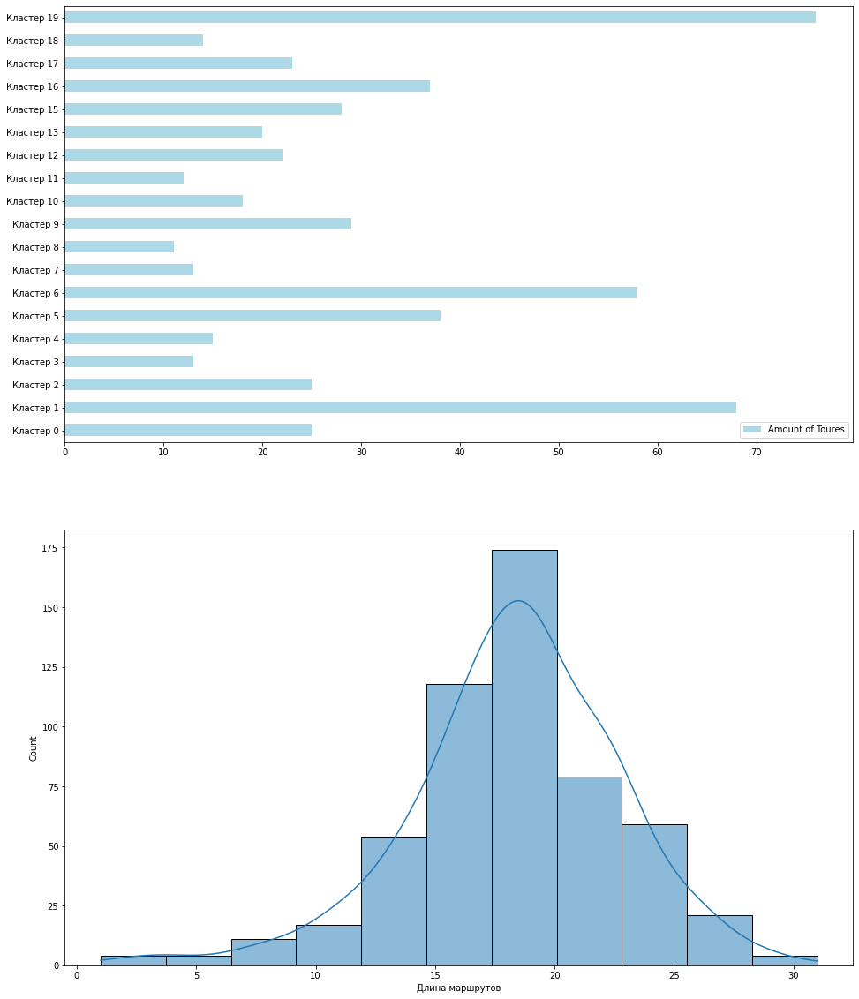

In [18]:
fig, ax = plt.subplots(2, 1, figsize=(16, 20))
info_about_toures.plot.barh(ax=ax[0], color='lightblue')
sns.histplot(routes_length, bins='sturges', ax=ax[1], kde=True)
ax[1].set_xlabel('Длина маршрутов')
plt.show()